In [34]:
import glob
from IPython.display import Audio
import librosa
import matplotlib.pyplot as plt
import numpy as np
import os
import pickle
from scipy.spatial import distance

SRATE = 22050
HOP_SIZE = 1024
CQT_BINS = 90
N_MFCC = 14
N_DECIMALS = 3

%matplotlib inline

## Data Collection ##

In [12]:
# Get all Meshuggah audio files (sorted)
audio_files = glob.glob("../audio/*.mp3")
audio_files.sort()
onset_dir = "../onsets"

In [15]:
def compute_features(audio_file):
    """Computes the onsets and the MFCC and CQT onset-synchronous features from the given
    audio file path.
    
    Parameters
    ----------
    audio_file : str
        Path to the audio file
    
    Returns
    -------
    y : np.array
        Audio samples
    onset_times : np.array
        Onset times in seconds
    mfcc_sync : np.array
        MFCC synchronized to the onsets
    cqt_sync : np.array
        CQT features synchronized to the onsets
    """
    # Read audio file
    y, sr = librosa.load(audio_file, sr=SRATE)
    
    # Detect onset
    onsets = librosa.onset.onset_detect(y, sr=SRATE, hop_length=HOP_SIZE)
    onset_times = librosa.frames_to_time(onsets, sr=SRATE,
                                         hop_length=HOP_SIZE)
    
    # Add first and last onsets (start and end of track)
    dur = librosa.core.get_duration(y=y, sr=SRATE, hop_length=HOP_SIZE)
    if onset_times[0] != 0:
        onset_times = np.concatenate(([0], onset_times))
    if onset_times[-1] != dur:
        onset_times = np.concatenate((onset_times, [dur]))
    
    # Compute MFCC (timbre features)
    mfcc = librosa.feature.mfcc(y=y, sr=SRATE, hop_length=HOP_SIZE, n_mfcc=N_MFCC)
    
    # Compute Constant-Q Transform
#     import pdb; pdb.set_trace()
    cqt = librosa.logamplitude(librosa.cqt(y, sr=SRATE, hop_length=HOP_SIZE,
                                           n_bins=CQT_BINS) ** 2,
                               ref_power=np.max)
    
    # Synchronize features to onsets
    mfcc_sync = librosa.feature.sync(mfcc, librosa.time_to_frames(onset_times, sr=SRATE, 
                                                                  hop_length=HOP_SIZE), pad=False)
    cqt_sync = librosa.feature.sync(cqt, librosa.time_to_frames(onset_times, sr=SRATE, 
                                                                  hop_length=HOP_SIZE), pad=False)
    
    return y, onset_times, mfcc_sync, cqt_sync
    
    
def create_onset(onset_id, song_id, start, end, onset_file, onset_audio):
    """Creates a new onset given the onset info. Also creates onset wav file.
    
    Parameters
    ----------
    onset_id : int
        Onset identifier.
    song_id : string
        Song identifier (original mp3 file name)
    start : float
        Start time of onset within song (in seconds)
    end : float
        End time of onset within song (in seconds)
    onset_file : str
        Path to the onset file
    onset_audio : np.array
        Audio samples containing the actual onset audio
    
    Returns
    -------
    onset_dict : dict
        Onset data ready to be inserted into the database.
    """
    onset_dict = {}
    onset_dict["onset_id"] = onset_id
    onset_dict["song_id"] = song_id
    onset_dict["start"] = start
    onset_dict["end"] = end
    onset_dict["onset_file"] = onset_file
    
    # Split audio and create wav
    librosa.output.write_wav(os.path.join(onset_dir, onset_file), onset_audio, 
                             sr=SRATE, norm=False)
    return onset_dict

In [64]:
# Compute onsets for all audio files
onset_id = 0
onset_dicts = []   # To ingest dataset
X = []             # MFCC matrix
Y = []             # CQT matrix
for i, audio_file in enumerate(audio_files):
    print audio_file
    y, onset_times, mfcc_sync, cqt_sync = compute_features(audio_file)
    
    # Store MFCCs and CQT into big onset MFCC and CQT matrix
    X = mfcc_sync if len(X) == 0 else np.hstack((X, mfcc_sync))
    Y = cqt_sync if len(Y) == 0 else np.hstack((Y, cqt_sync))
    
    # Create onsets for the current track
    for start, end in zip(onset_times[:-1], onset_times[1:]):
        start_end_times = librosa.time_to_samples(np.array([start, end]), sr=SRATE)
        onset_audio = y[start_end_times[0]:start_end_times[1]]
        onset_file = os.path.basename(audio_file)[:-4] + "-onset" + str(onset_id) + ".wav"
        onset_dict = create_onset(onset_id, os.path.basename(audio_file),
                                  start, end, onset_file, onset_audio)
        onset_id += 1
        
        # Store dictionary
        onset_dicts.append(onset_dict)

../audio/01 Combustion.mp3
../audio/02 Electric Red.mp3
../audio/03 Bleed.mp3
../audio/04 Lethargica.mp3
../audio/05 obZen.mp3
../audio/06 This Spiteful Snake.mp3
../audio/07 Pineal Gland Optics.mp3
../audio/08 Pravus.mp3
../audio/09 Dancers To A Discordant System.mp3
../audio/Meshuggah - 01 - Concatenation.mp3
../audio/Meshuggah - 02 - New Millenium Cyanide Christ.mp3
../audio/Meshuggah - 03 - Corridor Of Chameleons.mp3
../audio/Meshuggah - 04 - Neurotica.mp3
../audio/Meshuggah - 05 - The Mouth Licking What You've Bled.mp3
../audio/Meshuggah - 06 - Sane.mp3
../audio/Meshuggah - 07 - The Exquisite Machinery Of Torture.mp3
../audio/Meshuggah - 08 - Elastic.mp3
../audio/Meshuggah - Autonomy Lost.mp3
../audio/Meshuggah - Dehumanization.mp3
../audio/Meshuggah - Disenchantment.mp3
../audio/Meshuggah - Entrapment.mp3
../audio/Meshuggah - Imprint of the unsaved.mp3
../audio/Meshuggah - In death - is life.mp3
../audio/Meshuggah - Personae non gratae.mp3
../audio/Meshuggah - Re-inanimate.mp3
..

In [8]:
# Sonify Onsets
audio_file = "/Users/onieto/Downloads/Britney Spears - Toxic.mp3"
y, onset_times, mfcc_sync = compute_features(audio_file)
onset_clicks = librosa.clicks(times=onset_times, sr=SRATE, hop_length=HOP_SIZE)
audio_clicks = y[:onset_clicks.size] + onset_clicks
Audio(data=audio_clicks, rate=SRATE)

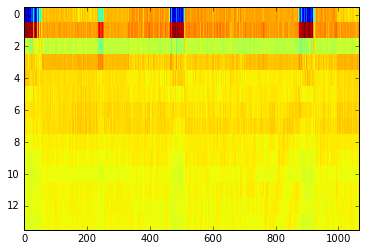

In [22]:
mfcc_sync = librosa.feature.sync(mfcc, onsets, pad=False)
plt.imshow(mfcc_sync, interpolation="nearest", aspect="auto")

In [61]:
print onset_dicts[:10]

[{'onset_file': '01 Combustion-onset0.wav', 'start': 0.8126984126984127, 'song_id': '01 Combustion.mp3', 'end': 1.0681179138321995, 'onset_id': 0}, {'onset_file': '01 Combustion-onset1.wav', 'start': 1.0681179138321995, 'song_id': '01 Combustion.mp3', 'end': 1.230657596371882, 'onset_id': 1}, {'onset_file': '01 Combustion-onset2.wav', 'start': 1.230657596371882, 'song_id': '01 Combustion.mp3', 'end': 1.3467573696145125, 'onset_id': 2}, {'onset_file': '01 Combustion-onset3.wav', 'start': 1.3467573696145125, 'song_id': '01 Combustion.mp3', 'end': 1.486077097505669, 'onset_id': 3}, {'onset_file': '01 Combustion-onset4.wav', 'start': 1.486077097505669, 'song_id': '01 Combustion.mp3', 'end': 1.6253968253968254, 'onset_id': 4}, {'onset_file': '01 Combustion-onset5.wav', 'start': 1.6253968253968254, 'song_id': '01 Combustion.mp3', 'end': 1.7879365079365079, 'onset_id': 5}, {'onset_file': '01 Combustion-onset6.wav', 'start': 1.7879365079365079, 'song_id': '01 Combustion.mp3', 'end': 1.88081632

## Meshuggahme Main ##

In [121]:
def improve_log(feats):
    return np.log1p(feats[:, :] + np.abs(np.min(feats)))

def improve_log_no_loudness(feats):
    return np.log1p(feats[:, 1:] + np.abs(np.min(feats)))

def improve_normal(feats):
    return feats

def meshuggahme(input_file, features, improve_func, metric='cosine', output_file='output.wav',
                original_w=8):
    """Converts the given input file into a Meshuggah track and saves it into disk as a wav file.
    
    Parameters
    ----------
    input_file : str
        Path to the input audio file to be converted.
    features : np.array
        Model of features to use (either MFCCs or CQT)
    improve_func : function
        One of the _improve_ functions (see above)
    metric : str
        One of the scipy.spatial.distance functions
    output_file : str
        Path to the output wav file
    original_w : f
    """
    y, onset_times, mfcc_sync, cqt_sync = compute_features(input_file)
#     assert mfcc_sync.shape[1] == cqt_sync.shape[1] and \
#         cqt_sync.shape[1] == len(zip(onset_times[:-1], onset_times[1:])) - 1
        
    # Select feature
    if features.shape[0] == CQT_BINS:
        feat_sync = cqt_sync
    elif features.shape[0] == N_MFCC:
        feat_sync = mfcc_sync
    
    # Construct
    for feat, (start, end) in zip(feat_sync.T, zip(onset_times[:-1], onset_times[1:])):
        # Get start and end times in samples
        start_end_samples = librosa.time_to_samples(np.array([start, end]), sr=SRATE)
        
        # Compute minimum distance from all the matrix of onsets
        D = distance.cdist(improve_func(features.T), improve_func(feat.reshape((1, -1))), 
                           metric=metric)
        argsorted = np.argsort(D.flatten())
        
        # Find onset id with at least the same duration as the meshuggah onset
        sort_idx = 0
        dur = 0
        while True:
            onset_id = argsorted[sort_idx]
        
            # Get dictionary
            onset_dict = onset_dicts[onset_id]
            
            # Increase index to go to the next closest meshuggah onset
            sort_idx += 1
            
            # Try to concatenate
            x, sr = librosa.load(os.path.join(onset_dir, onset_dict["onset_file"]), sr=SRATE)
            if len(y[start_end_samples[0]:start_end_samples[1]]) <= len(x):
                break
        
        # Concatenate new audio
        w = np.min([(D[onset_id][0] + np.abs(np.min(D))) * 3, 1])  # Normalize weight
        y[start_end_samples[0]:start_end_samples[1]] = y[start_end_samples[0]:start_end_samples[1]] * w + \
            x[:start_end_samples[1] - start_end_samples[0]] * (1 - w)
    
    # Write new audio file
    librosa.output.write_wav(output_file, y, sr=SRATE)

In [123]:
# Calling MESHUGGAHME
metric = 'cosine'
# meshuggahme("../audio/01 Combustion.mp3", X, improve_func=improve_normal, metric=metric)
# meshuggahme("/Users/onieto/Downloads/Britney Spears - Toxic_short.wav", X, improve_func=improve_normal, metric=metric)
# meshuggahme("/Users/onieto/Downloads/QUEEN - Bohemian Rhapsody (Video & Lyrics on Screen).mp3", Y, improve_func=improve_normal, metric=metric)
meshuggahme("/Users/onieto/Downloads/Miley Cyrus - Wrecking Ball.mp3", Y, improve_func=improve_normal, metric=metric)
# meshuggahme("/Users/onieto/Downloads/Iron Maiden - Aces High (Official Video).mp3", Y, improve_func=improve_normal, metric=metric)

0.0028916958264 0.000891671249796
0.0833365093845 0.0138894182308
0.087914334829 0.0146523891382
0.0711222899187 0.0118537149864
0.0653256088589 0.0108876014765
0.0617022959921 0.0102837159987
0.0646926913982 0.010782115233
0.068396250691 0.0113993751152
0.0796504769917 0.0132750794986
0.0783255698954 0.0130542616492
0.0732652067815 0.0122108677969
0.0744987961609 0.0124164660268
0.0719602221112 0.0119933703519
0.0618270013939 0.0103045002323
0.0770756359204 0.0128459393201
0.0590869865139 0.00984783108565
0.075831694263 0.0126386157105
0.0717177665123 0.0119529610854
0.069871448097 0.0116452413495
0.0587623732784 0.00979372887973
0.0572657901349 0.00954429835581
0.0637389995729 0.0106231665955
0.0605515975987 0.0100919329331
0.0599337006293 0.00998895010489
0.0669283573171 0.0111547262195
0.0973473794232 0.0162245632372
0.0805577642039 0.013426294034
0.0719821507999 0.0119970251333
0.0734434646254 0.0122405774376
0.0658536672511 0.0109756112085
0.0839445629155 0.0139907604859
0.104213

## Sandbox ##

In [77]:
argsorted = np.argsort(D.flatten())
onset_id = argsorted[0]
onset_dict = onset_dicts[onset_id]
x, sr = librosa.load(os.path.join(onset_dir, onset_dict["onset_file"]), sr=SRATE)
x = np.concatenate((x, x))
print onset_dict

{'onset_file': '01 Combustion-onset1.wav', 'start': 0.8126984126984127, 'song_id': '01 Combustion.mp3', 'end': 1.0681179138321995, 'onset_id': 1}


In [65]:
# Save models
with open("onset_dicts.pk", "w") as fp:
    pickle.dump(onset_dicts, fp, protocol=-1)
with open("X.pk", "w") as fp:
    pickle.dump(X, fp, protocol=-1)
with open("Y.pk", "w") as fp:
    pickle.dump(Y, fp, protocol=-1)    

In [67]:
# Load models
with open("onset_dicts.pk") as fp:
    onset_dicts = pickle.load(fp)
with open("X.pk") as fp:
    X = pickle.load(fp)
with open("Y.pk") as fp:
    Y = pickle.load(fp)